<a href="https://colab.research.google.com/github/raghusbhat/colab/blob/main/Depth_small_v6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from transformers import AutoModelForDepthEstimation, pipeline
from PIL import Image
import requests
import time
import matplotlib.pyplot as plt

In [ ]:
# Download model
model_name = "LiheYoung/depth-anything-small-hf"
model = AutoModelForDepthEstimation.from_pretrained(model_name)
pipe = pipeline(task="depth-estimation", model=model_name)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/954 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/99.2M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/437 [00:00<?, ?B/s]

In [ ]:
# Function for inference
def depth_estimation(image_path):
    image = Image.open(image_path)
    image = image.resize((256, 256))
    start_time = time.time()
    depth = pipe(image)["depth"]
    end_time = time.time()
    inference_time = (end_time - start_time) * 1000
    print(f"Inference time: {inference_time:.2f} ms")
    return depth

## Load the sample image to Colab and rename accordingly

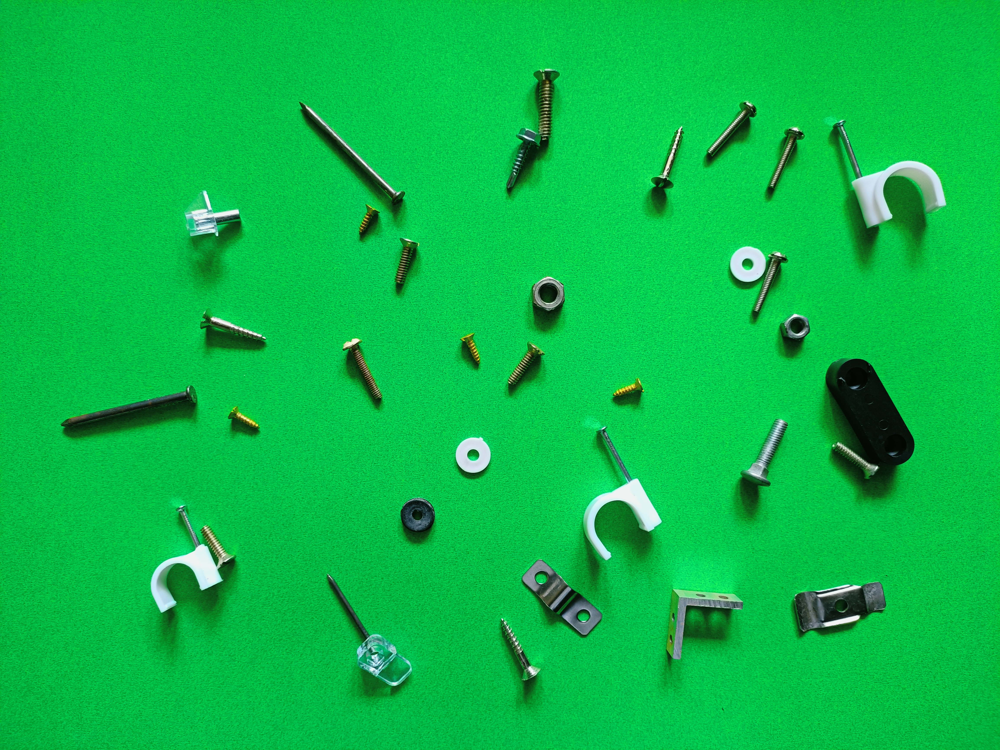

In [ ]:
# Load image from Colab filesystem
image_path = '/content/4K.jpg'
# image = Image.open(image_path)
# image

In [ ]:
# Perform depth estimation
depth_map = depth_estimation(image_path)

Inference time: 7032.27 ms


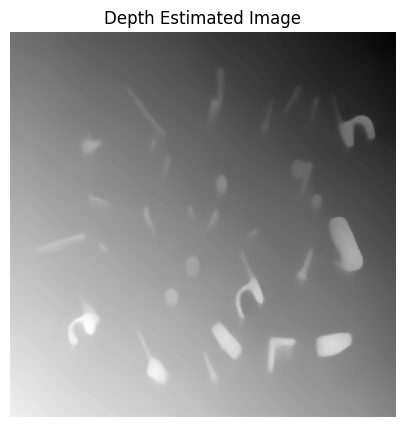

In [ ]:
# Display the depth map using matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(depth_map, cmap='gray')
plt.axis('off')
plt.title('Depth Estimated Image')
plt.show()